In [1]:
from pathlib import Path
from pathml.core import HESlide, SlideDataset
from histolab.slide import Slide
import os

In [14]:
filepath = os.getcwd()
process_path = os.path.join(filepath, 'he_test')
filepath = "HE_Hamamatsu.ndpi"
init_slide = Slide(filepath, process_path)

In [3]:
print(f"Slide name: {init_slide.name}")
print(f"Levels: {init_slide.levels}")
print(f"Dimensions at level 0: {init_slide.dimensions}")
print(f"Dimensions at level 1: {init_slide.level_dimensions(level=1)}")
print(f"Dimensions at level 2: {init_slide.level_dimensions(level=2)}")
print(f"Dimensions at level 3: {init_slide.level_dimensions(level=3)}")
print(f"Dimensions at level 4: {init_slide.level_dimensions(level=4)}")
print(f"Dimensions at level 5: {init_slide.level_dimensions(level=5)}")

Slide name: OS-1
Levels: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]
Dimensions at level 0: (122880, 110592)
Dimensions at level 1: (61440, 55296)
Dimensions at level 2: (30720, 27648)
Dimensions at level 3: (15360, 13824)
Dimensions at level 4: (7680, 6912)
Dimensions at level 5: (3840, 3456)


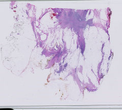

In [4]:
init_slide.thumbnail

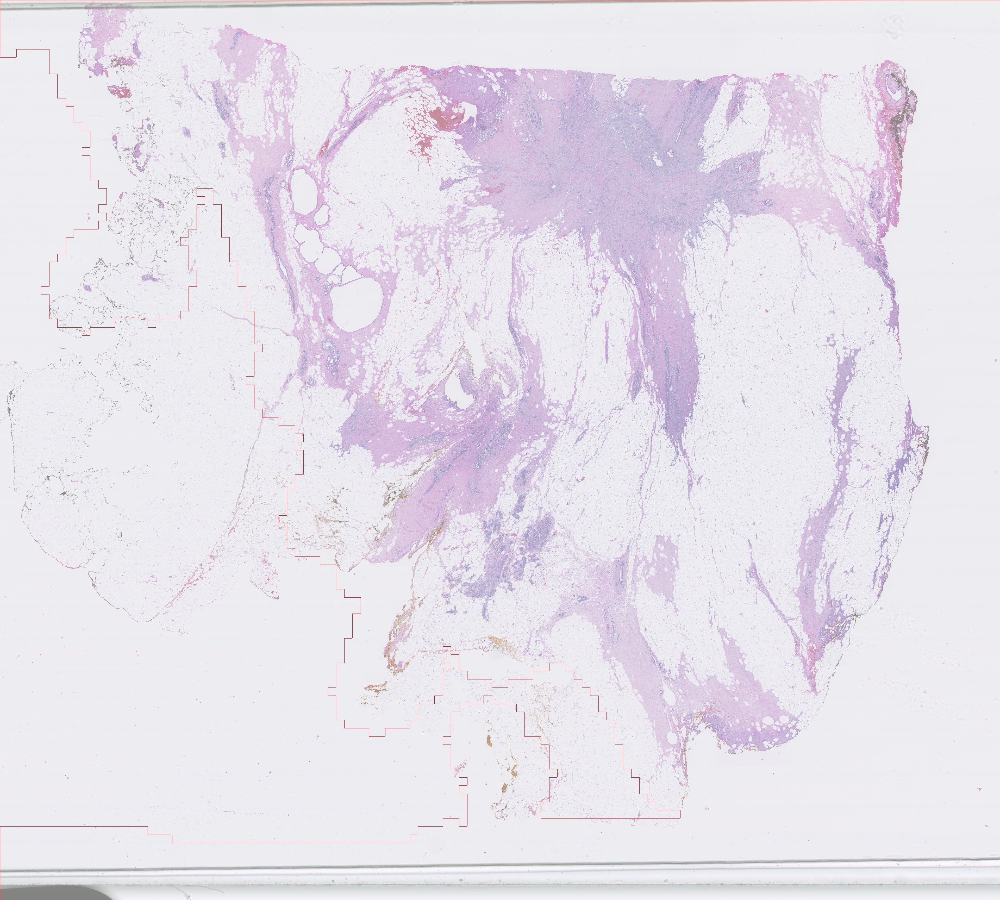

In [5]:
from histolab.masks import TissueMask
import numpy as np
all_tissue_mask = TissueMask()
init_slide.locate_mask(all_tissue_mask)

In [6]:
binary_mask: np.ndarray = all_tissue_mask(init_slide)

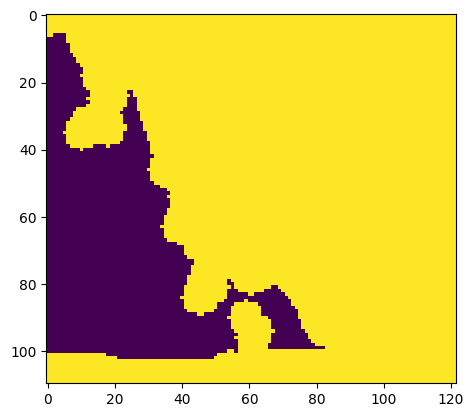

In [7]:
from matplotlib import pyplot as plt
plt.imshow(binary_mask, interpolation='nearest')
plt.show()

In [8]:
from histolab.util import regions_from_binary_mask
regions = regions_from_binary_mask(binary_mask)

In [9]:
import numpy as np
import matplotlib.pyplot as plt

from pathml.core import HESlide
from pathml.preprocessing import StainNormalizationHE

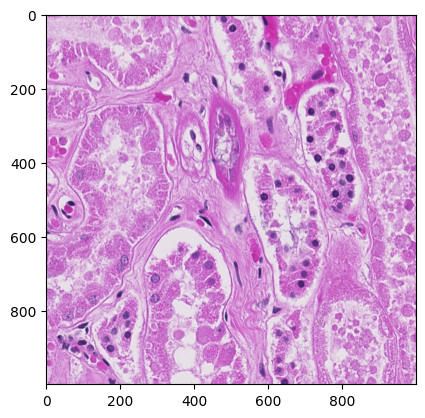

In [10]:
wsi = HESlide("HE_Hamamatsu.ndpi")
region = wsi.slide.extract_region(location = (10000, 10000), size = (1000, 1000))
plt.imshow(region)

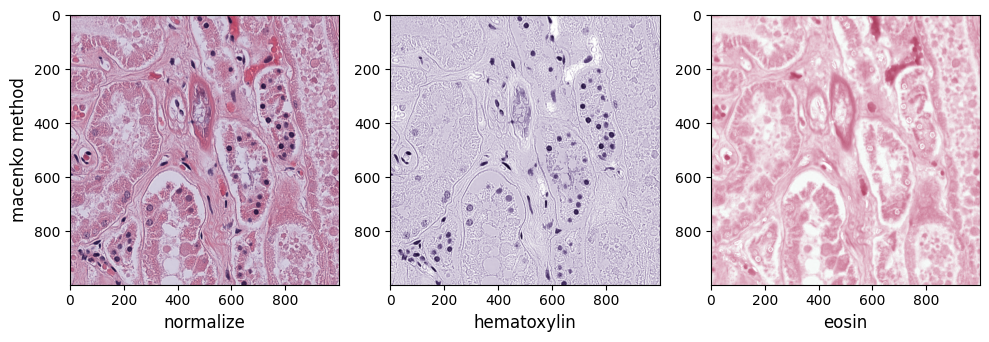

In [33]:
fig, axarr = plt.subplots(nrows=1, ncols=3, figsize=(10, 7.5))

method = "macenko"
fontsize = 12
for j, target in enumerate(["normalize", "hematoxylin", "eosin"]):
    normalizer = StainNormalizationHE(target = target, stain_estimation_method = "macenko")
    im = normalizer.F(region)
    ax = axarr[j]
    # plot results
    ax.imshow(im)
    ax.set_xlabel(f"{target}", fontsize=fontsize)
    if j == 0:
        ax.set_ylabel(f"{method} method", fontsize=fontsize)

plt.tight_layout()
plt.show()

In [48]:
import numpy as np
from tqdm import tqdm
import copy
import matplotlib.pyplot as plt
from matplotlib import cm
import torch
from torch.optim.lr_scheduler import StepLR
import albumentations as A

In [27]:
from pathml.datasets.pannuke import PanNukeDataModule
from pathml.ml.hovernet import HoVerNet, loss_hovernet, post_process_batch_hovernet
from pathml.ml.utils import wrap_transform_multichannel, dice_score
from pathml.utils import plot_segmentation


In [37]:
import matplotlib.pyplot as plt
import copy

from pathml.core import HESlide, Tile, types
from pathml.utils import plot_mask, RGB_to_GREY
from pathml.preprocessing import (
    BoxBlur, GaussianBlur, MedianBlur,
    NucleusDetectionHE, StainNormalizationHE, SuperpixelInterpolation,
    ForegroundDetection, TissueDetectionHE, BinaryThreshold,
    MorphClose, MorphOpen
)

fontsize = 14


In [39]:
def smalltile():
    # convenience function to create a new tile
    return Tile(region, coords = (0, 0), name = "testregion", slide_type = types.HE)

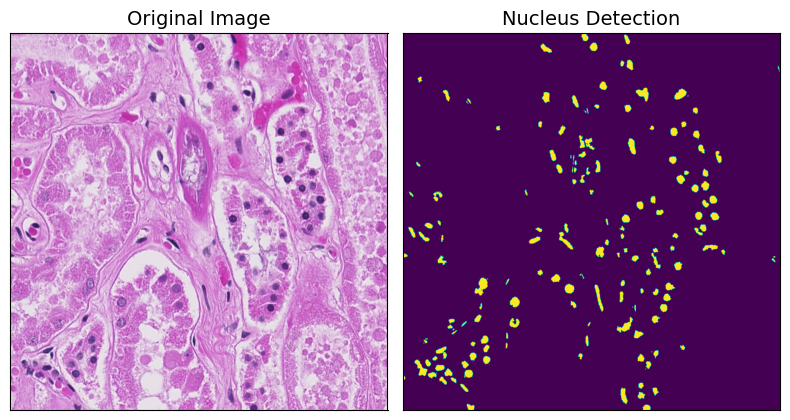

In [42]:
tile = smalltile()
nucleus_detection = NucleusDetectionHE(mask_name = "detect_nuclei")
nucleus_detection.apply(tile)

fig, axarr = plt.subplots(nrows=1, ncols=2, figsize=(8, 8))
axarr[0].imshow(tile.image)
axarr[0].set_title("Original Image", fontsize=fontsize)
axarr[1].imshow(tile.masks["detect_nuclei"])
axarr[1].set_title("Nucleus Detection", fontsize=fontsize)
for ax in axarr.ravel():
    ax.set_yticks([])
    ax.set_xticks([])
plt.tight_layout()
plt.show()

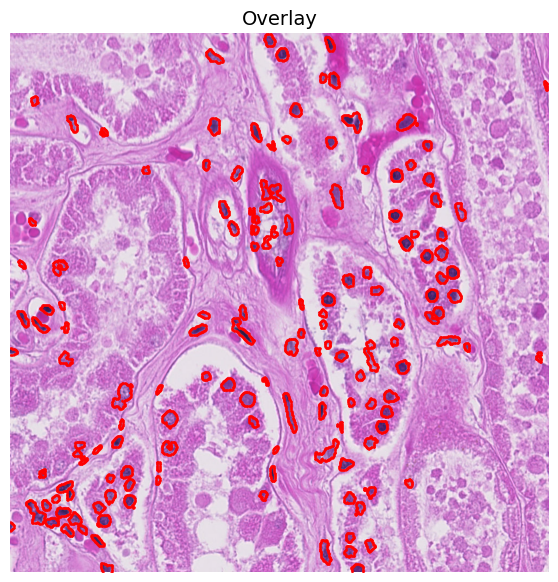

In [43]:
fig, ax = plt.subplots(figsize=(7, 7))
plot_mask(im = tile.image, mask_in=tile.masks["detect_nuclei"], ax = ax)
plt.title("Overlay", fontsize = fontsize)
plt.axis('off')
plt.show()

In [62]:
n_classes_pannuke = 6

# data augmentation transform
hover_transform = A.Compose(
    [A.VerticalFlip(p=0.5),
     A.HorizontalFlip(p=0.5),
     A.RandomRotate90(p=0.5),
     A.GaussianBlur(p=0.5),
     A.MedianBlur(p=0.5, blur_limit=5)],
    additional_targets = {f"mask{i}" : "mask" for i in range(n_classes_pannuke)}
)

transform = wrap_transform_multichannel(hover_transform)


In [63]:


import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
import seaborn
import cv2
import torch

from PIL import Image
from tqdm import tqdm



In [64]:


!git clone https://github.com/vqdang/hover_net.git
%cd hover_net



Cloning into 'hover_net'...
remote: Enumerating objects: 2032, done.
remote: Counting objects: 100% (504/504), done.
remote: Compressing objects: 100% (94/94), done.
remote: Total 2032 (delta 431), reused 411 (delta 410), pack-reused 1528
Receiving objects: 100% (2032/2032), 40.39 MiB | 20.14 MiB/s, done.
Resolving deltas: 100% (1249/1249), done.
/home/gazal/Documents/hover_net


In [65]:
%%writefile dataset.py

import glob
import cv2
import numpy as np
import scipy.io as sio


class __AbstractDataset(object):
    """Abstract class for interface of subsequent classes.
    Main idea is to encapsulate how each dataset should parse
    their images and annotations.
    
    """

    def load_img(self, path):
        raise NotImplementedError

    def load_ann(self, path, with_type=False):
        raise NotImplementedError


####
class __PanNuke(__AbstractDataset):

    def load_img(self, path):
        return cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)

    def load_ann(self, path, with_type=False):
        # assumes that ann is HxW
        assert not with_type, "Not support"
        ann_inst = sio.loadmat(path)["inst_map"]
        ann_inst = ann_inst.astype("int32")
        ann = np.expand_dims(ann_inst, -1)
        return ann


####
def get_dataset(name):
    """Return a pre-defined dataset object associated with `name`."""
    name_dict = {
        "pannuke": lambda: __PanNuke(),
    }
    if name.lower() in name_dict:
        return name_dict[name]()
    else:
        assert False, "Unknown dataset `%s`" % name

Overwriting dataset.py


In [66]:
%%writefile dataset.py

import glob
import cv2
import numpy as np
import scipy.io as sio


class __AbstractDataset(object):
    """Abstract class for interface of subsequent classes.
    Main idea is to encapsulate how each dataset should parse
    their images and annotations.
    
    """

    def load_img(self, path):
        raise NotImplementedError

    def load_ann(self, path, with_type=False):
        raise NotImplementedError


####
class __PanNuke(__AbstractDataset):

    def load_img(self, path):
        return cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)

    def load_ann(self, path, with_type=False):
        # assumes that ann is HxW
        assert not with_type, "Not support"
        ann_inst = sio.loadmat(path)["inst_map"]
        ann_inst = ann_inst.astype("int32")
        ann = np.expand_dims(ann_inst, -1)
        return ann


####
def get_dataset(name):
    """Return a pre-defined dataset object associated with `name`."""
    name_dict = {
        "pannuke": lambda: __PanNuke(),
    }
    if name.lower() in name_dict:
        return name_dict[name]()
    else:
        assert False, "Unknown dataset `%s`" % name

Overwriting dataset.py


In [6]:
from tiatoolbox.models.engine.nucleus_instance_segmentor import NucleusInstanceSegmentor
from tiatoolbox.utils.misc import imread
from tiatoolbox.wsicore.wsireader import WSIReader

import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import os, glob

mpl.rcParams['figure.dpi'] = 300 # for high resolution figure in notebook
plt.rcParams.update({'font.size': 5})

In [7]:
from tiatoolbox.utils.misc import download_data

# These file name are used for the experimenets
img_file_name = "sample_tile.png"
wsi_file_name = "sample_wsi.svs"


print('Download has started. Please wait...')

# Downloading sample image tile
download_data("https://tiatoolbox.dcs.warwick.ac.uk/sample_imgs/breast_tissue_crop.png", img_file_name)

# Downloading sample whole-slide image
download_data("https://tiatoolbox.dcs.warwick.ac.uk/sample_wsis/wsi4_12k_12k.svs", wsi_file_name)

print('Download is complete.')

Download has started. Please wait...
Download is complete.


In [18]:
# Tile prediction
inst_segmentor = NucleusInstanceSegmentor(
    pretrained_model="hovernet_fast-pannuke",
    num_loader_workers=2,
    num_postproc_workers=2,
    batch_size=4,
)

tile_output = inst_segmentor.predict(
        [img_file_name],
        save_dir="he_test_new_/",
        mode="tile",
        on_gpu=False,
        crash_on_exception=True,
    )

|2024-03-20|15:08:08.311| [WARNING] WSIPatchDataset only reads image tile at `units="baseline"`. Resolutions will be converted to baseline value.
|2024-03-20|15:08:08.336| [WARNING] WSIPatchDataset only reads image tile at `units="baseline"`. Resolutions will be converted to baseline value.
|2024-03-20|15:08:08.374| [WARNING] Raw data is None.
|2024-03-20|15:08:08.374| [WARNING] Unknown scale (no objective_power or mpp)


ModuleNotFoundError: No module named 'torch.nested._internal'

In [1]:
from histolab.data import prostate_tissue, ovarian_tissue

In [2]:
prostate_svs, prostate_path = prostate_tissue()
ovarian_svs, ovarian_path = ovarian_tissue()

In [3]:
from histolab.slide import Slide

In [4]:
import os

BASE_PATH = os.getcwd()

PROCESS_PATH_PROSTATE = os.path.join(BASE_PATH, 'prostate', 'processed')
PROCESS_PATH_OVARIAN = os.path.join(BASE_PATH, 'ovarian', 'processed')

prostate_slide = Slide(prostate_path, processed_path=PROCESS_PATH_PROSTATE)
ovarian_slide = Slide(ovarian_path, processed_path=PROCESS_PATH_OVARIAN)

In [5]:
print(f"Slide name: {prostate_slide.name}")
print(f"Levels: {prostate_slide.levels}")
print(f"Dimensions at level 0: {prostate_slide.dimensions}")
print(f"Dimensions at level 1: {prostate_slide.level_dimensions(level=1)}")
print(f"Dimensions at level 2: {prostate_slide.level_dimensions(level=2)}")

Slide name: TCGA-CH-5753-01A-01-BS1.4311c533-f9c1-4c6f-8b10-922daa3c2e3e
Levels: [0, 1, 2]
Dimensions at level 0: (16000, 15316)
Dimensions at level 1: (4000, 3829)
Dimensions at level 2: (2000, 1914)


In [6]:


prostate_slide.thumbnail
prostate_slide.show()



In [7]:
from histolab.tiler import GridTiler

In [8]:
grid_tiles_extractor = GridTiler(
   tile_size=(512, 512),
   level=0,
   check_tissue=True, # default
   pixel_overlap=0, # default
   prefix="grid/", # save tiles in the "grid" subdirectory of slide's processed_path
   suffix=".png" # default
)

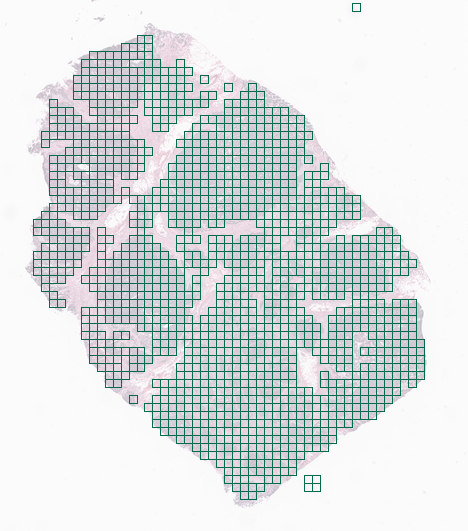

In [12]:
grid_tiles_extractor.locate_tiles(
    slide=ovarian_slide,
    scale_factor=64,
    alpha=64,
    outline="#046C4C",
)

In [15]:
grid_tiles_extractor.extract(init_slide)